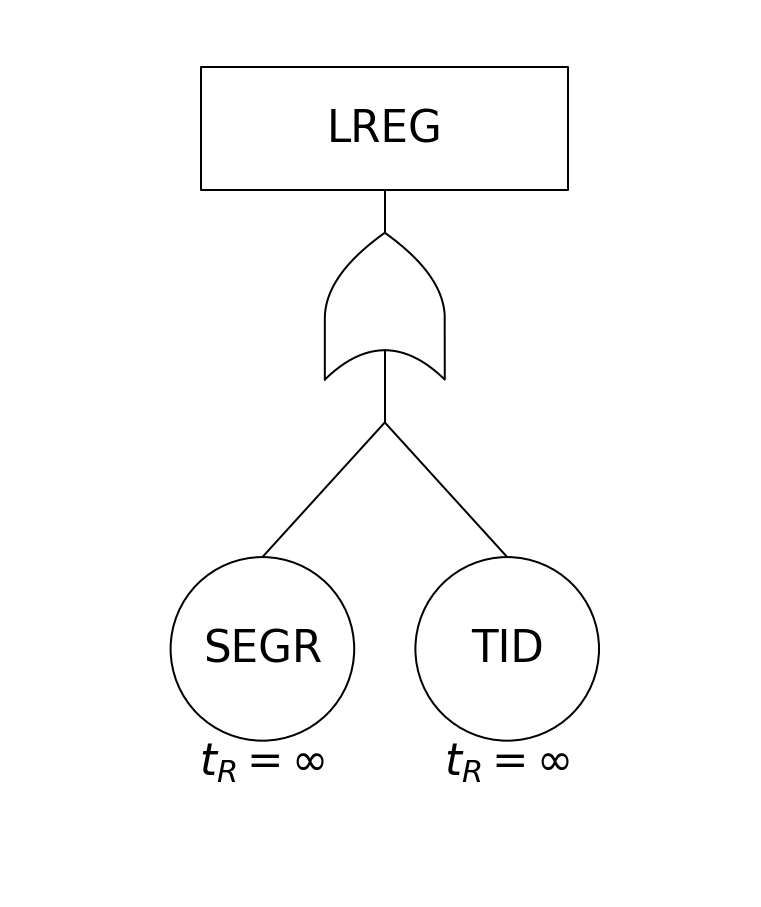

In [20]:
from lxml import etree
from radstats import diagram
system = etree.parse('sys/payload.xml')
subsystem = 'LREG'
diagram.FT(system,subsystem,times=True,probs=False)

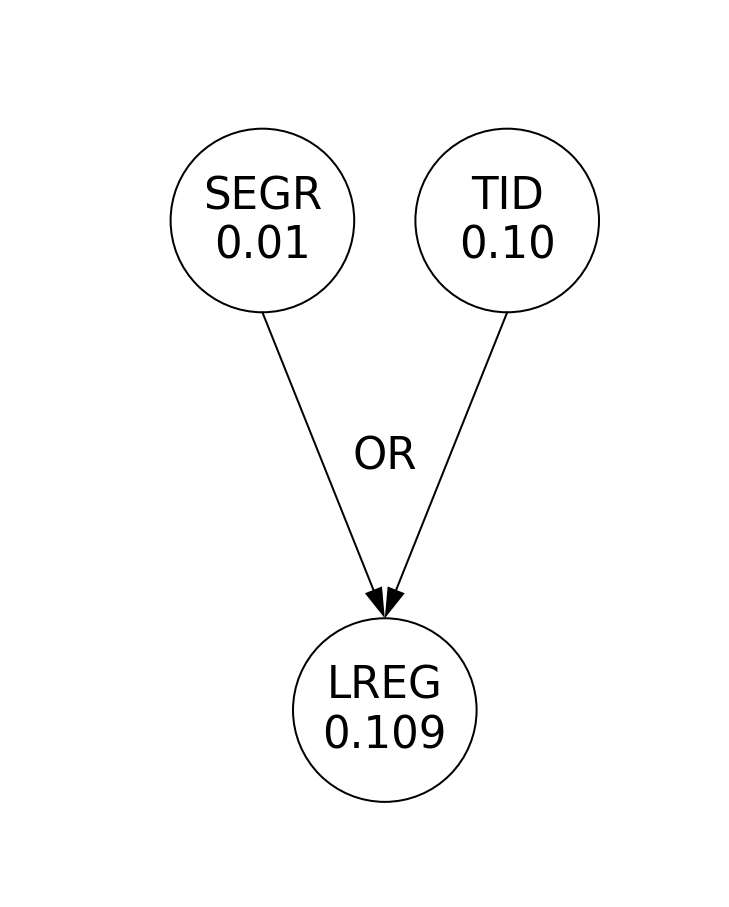

In [2]:
diagram.BN(system,subsystem,times=False)

In [3]:
from radstats import environment
env = environment.stitch('trajectory/MISSION',[(2,180)])
env

,MJD (days),Altitude (km),Latitude (deg),Longitude (deg),LocalTime (hrs),Alpha (deg),SegmentNum,SegmentName,Time (hrs),Time (s),...,dTTID,dSTID,dGTID,dTID,TDDD,SDDD,DDD,dTDDD,dSDDD,dDDD
0,0.002770,35778.83,0.0,246.745451,16.449697,90.0,2,GEO,0.066481,2.393315e+02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.005540,35778.83,0.0,246.745710,16.516381,90.0,2,GEO,0.132962,4.786630e+02,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.000014,0.000014,0.0,0.000014,0.000014
2,0.008310,35778.83,0.0,246.745970,16.583065,90.0,2,GEO,0.199443,7.179944e+02,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.000027,0.000027,0.0,0.000014,0.000014
3,0.011080,35778.83,0.0,246.746230,16.649749,90.0,2,GEO,0.265924,9.573259e+02,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.000041,0.000041,0.0,0.000014,0.000014
4,0.013850,35778.83,0.0,246.746490,16.716433,90.0,2,GEO,0.332405,1.196657e+03,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.000054,0.000054,0.0,0.000014,0.000014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64976,179.988905,35779.24,0.0,246.861570,16.190771,90.0,2,GEO,4319.733729,1.555104e+07,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.874888,0.874888,0.0,0.000014,0.000014
64977,179.991675,35779.23,0.0,246.861806,16.257454,90.0,2,GEO,4319.800210,1.555128e+07,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.874901,0.874901,0.0,0.000014,0.000014
64978,179.994445,35779.22,0.0,246.862042,16.324136,90.0,2,GEO,4319.866691,1.555152e+07,...,0.0,0.001457,1.858035e-08,0.001457,0.0,0.874915,0.874915,0.0,0.000014,0.000014
64979,179.997215,35778.83,0.0,246.745451,16.449697,90.0,2,GEO,4319.933172,1.555176e+07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
parts = {'GCR': {'LREG_SEGR': {'Saturation': 3e-07, 'Threshold': 20}},
        'Dose': {'LREG_TID': {'Mean': 4.5, 'StDev': 0.1}}}

In [8]:
from radstats import models
events = models.events(env,parts)
events

In [48]:
from radstats import plot
plot.dir = 'plots'
plot.probs(events,labels={'value':'Probability','variable':'Event'})

In [9]:
from radstats import bayes
faults = bayes.faults(system,events,subsystem)
faults

In [49]:
plot.probs(faults,labels={'value':'Probability','variable':'Failure'})

In [53]:
impo = bayes.importance(system,faults,subsystem)
impo['diagnostic']

,LREG_SEGR,LREG_TID,LREG
Time (hrs),,,
0.066481,1.0,0.0,1.0
0.132962,1.0,0.0,1.0
0.199443,1.0,0.0,1.0
0.265924,1.0,0.0,1.0
0.332405,1.0,0.0,1.0
...,...,...,...
4319.733729,0.00086,1.0,1.0
4319.800210,0.00086,1.0,1.0
4319.866691,0.00086,1.0,1.0


In [54]:
plot.probs(impo['diagnostic'],labels={'value':'Diagnostic Importance','variable':'Element'})